# Identifying Crime Hotspots in San Fracisco

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

data=pd.read_csv("train.csv")
data


,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541
5,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM UNLOCKED AUTO,Wednesday,INGLESIDE,NONE,0 Block of TEDDY AV,-122.403252,37.713431
6,2015-05-13 23:30:00,VEHICLE THEFT,STOLEN AUTOMOBILE,Wednesday,INGLESIDE,NONE,AVALON AV / PERU AV,-122.423327,37.725138
7,2015-05-13 23:30:00,VEHICLE THEFT,STOLEN AUTOMOBILE,Wednesday,BAYVIEW,NONE,KIRKWOOD AV / DONAHUE ST,-122.371274,37.727564
8,2015-05-13 23:00:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,RICHMOND,NONE,600 Block of 47TH AV,-122.508194,37.776601
9,2015-05-13 23:00:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,CENTRAL,NONE,JEFFERSON ST / LEAVENWORTH ST,-122.419088,37.807802


## Identifying Outliers In Latitudes & Longitudes

Using Scatter Plot To Visualise Outliers of Longitude and Latitude

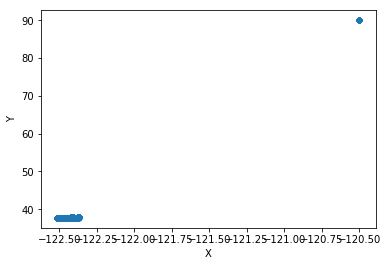

In [2]:
data.plot.scatter('X','Y')

## Outliers Detected
Thus, Outliers are dropped

In [3]:
data['Xok'] = data[data.X<-121].X
data['Yok'] = data[data.Y<40].Y
data = data.dropna()

## Visualize Filtered Data

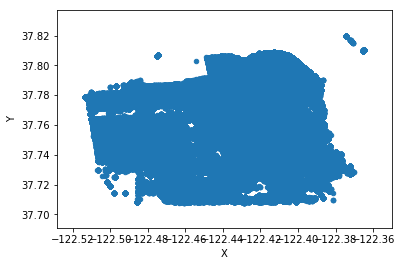

In [4]:
data.plot.scatter('X','Y')

## Preparation of Categorical Data

In [5]:
Theft = data[data.Category.isin(['LARCENY/THEFT'])]
OtherOffenses = data[data.Category.isin(['OTHER OFFENSES'])]
NonCriminal = data[data.Category.isin(['NON-CRIMINAL'])]
Assault = data[data.Category.isin(['ASSAULT'])]
Drug = data[data.Category.isin(['DRUG/NARCOTIC'])]
VehicleTheft = data[data.Category.isin(['VEHICLE THEFT'])]
Vandalism = data[data.Category.isin(['VANDALISM'])]
Warrants = data[data.Category.isin(['WARRANTS'])]
Burglary = data[data.Category.isin(['BURGLARY'])]
SuspiciousOcc = data[data.Category.isin(['SUSPICIOUS OCC'])]
Trea = data[data.Category.isin(['TREA'])]

### Create Map Boundaries For San Francisco
Side note : Must use filtered data

In [6]:
BBox = (data.X.min(),data.X.max(),data.Y.min(),data.Y.max())
BBox

(-122.51364206429, -122.36493749408001, 37.7078790224135, 37.819975492297004)

### Import Map From OpenStreetMap.Com
Insert BBox Coordinates

In [7]:
SanFranciscoMap = plt.imread('C:/Users/T947713/Downloads/Category.png')

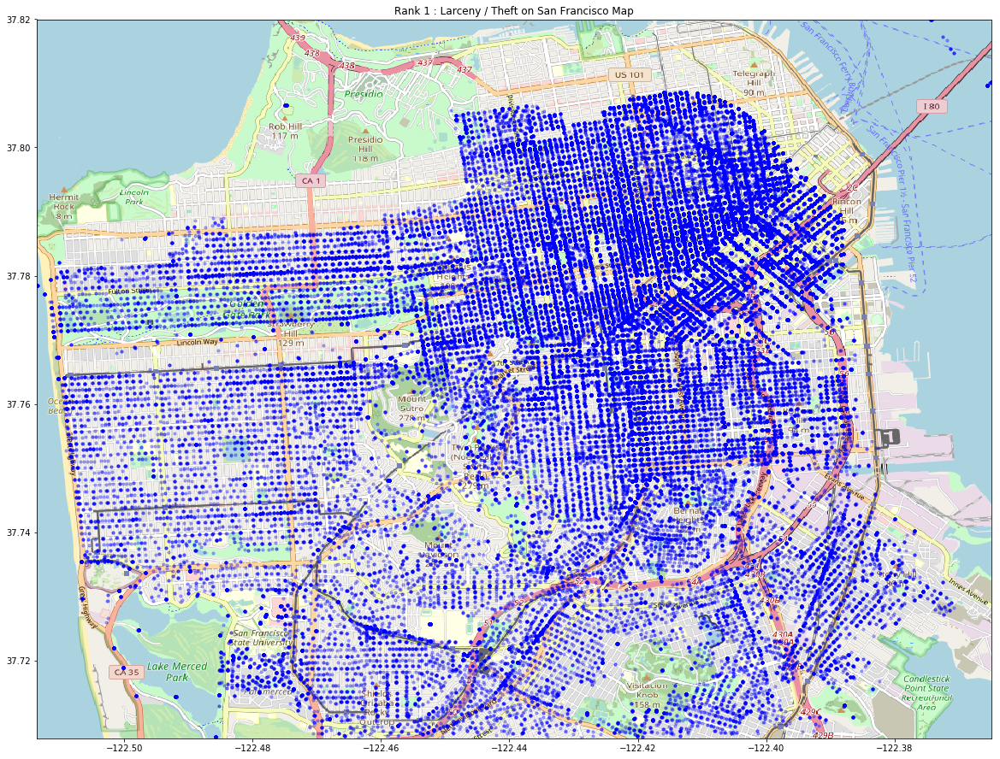

In [8]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Theft.X, Theft.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 1 : Larceny / Theft on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

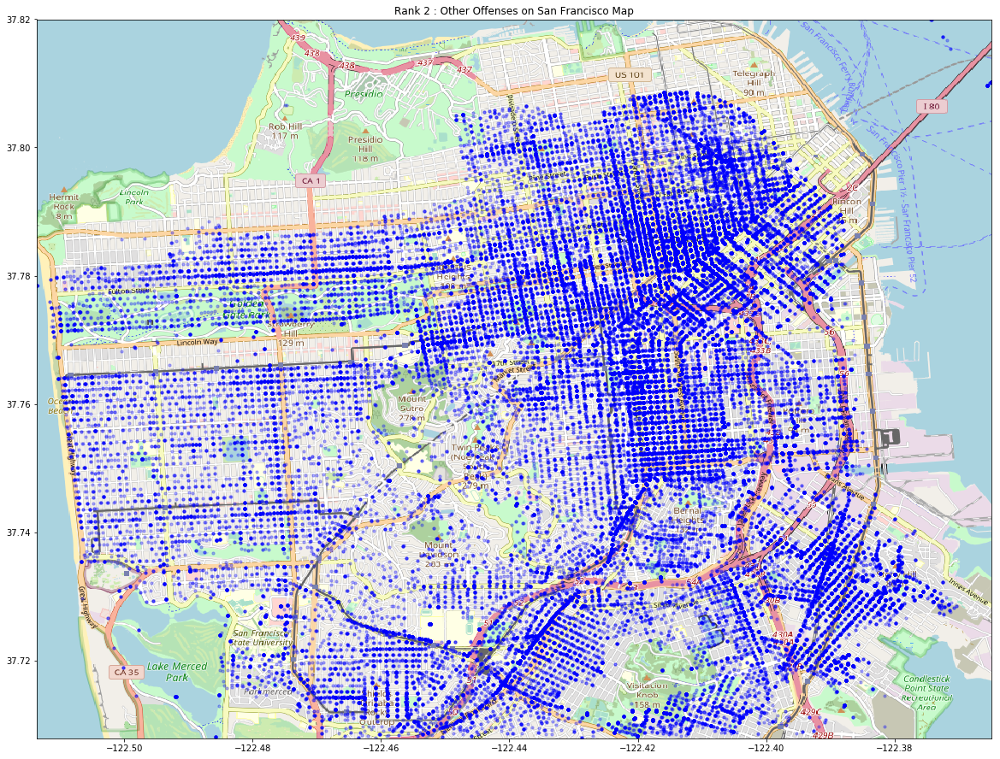

In [9]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(OtherOffenses.X, OtherOffenses.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 2 : Other Offenses on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

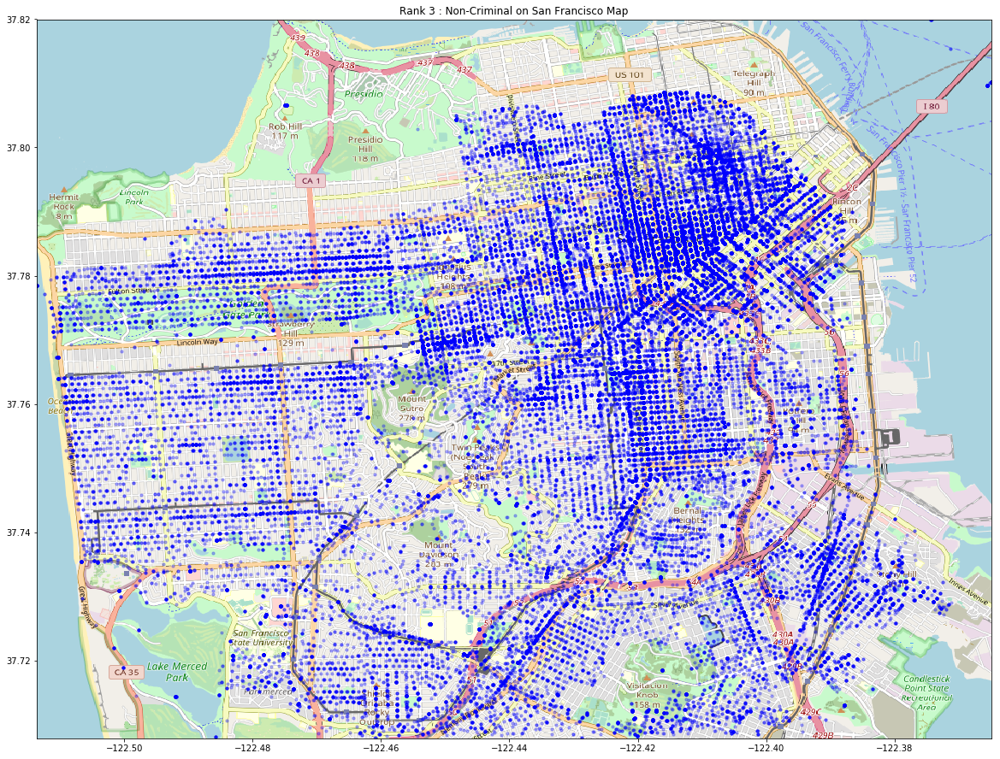

In [10]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(NonCriminal.X, NonCriminal.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 3 : Non-Criminal on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

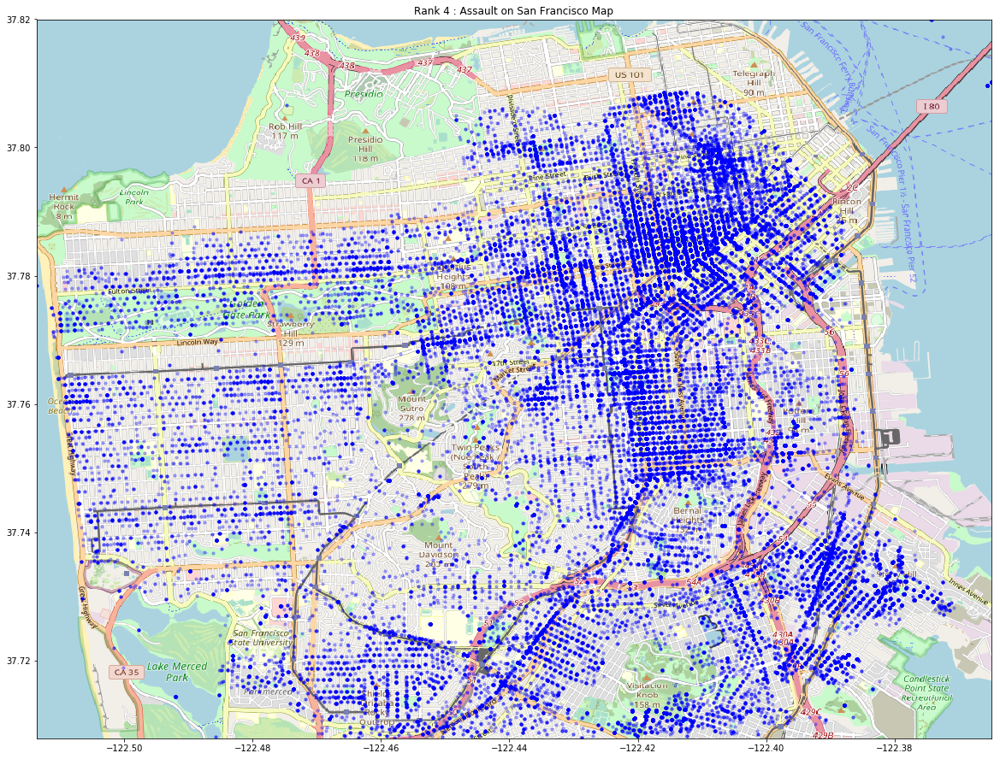

In [11]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Assault.X, Assault.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 4 : Assault on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

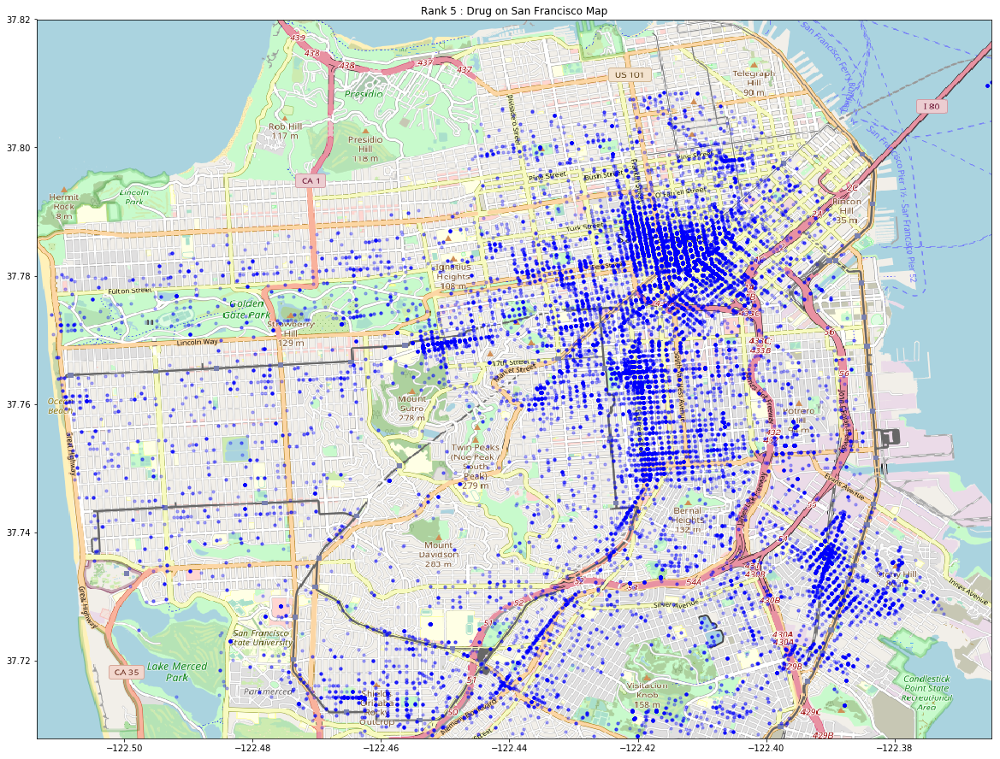

In [12]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Drug.X, Drug.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 5 : Drug on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

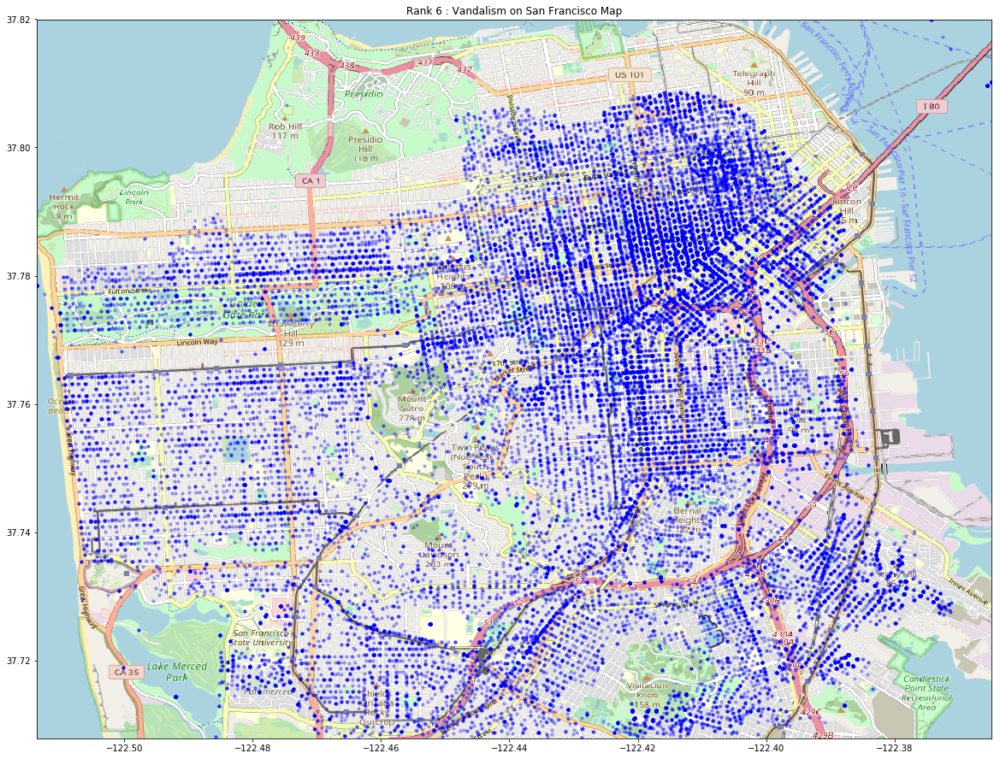

In [13]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Vandalism.X, Vandalism.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 6 : Vandalism on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

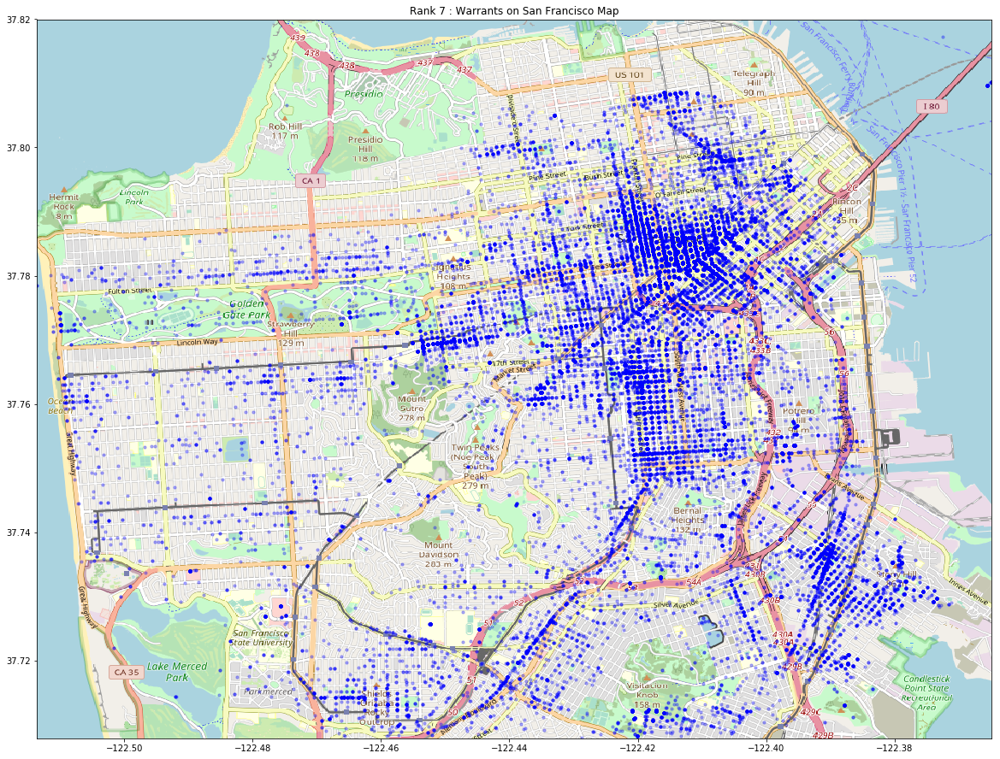

In [14]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Warrants.X, Warrants.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 7 : Warrants on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

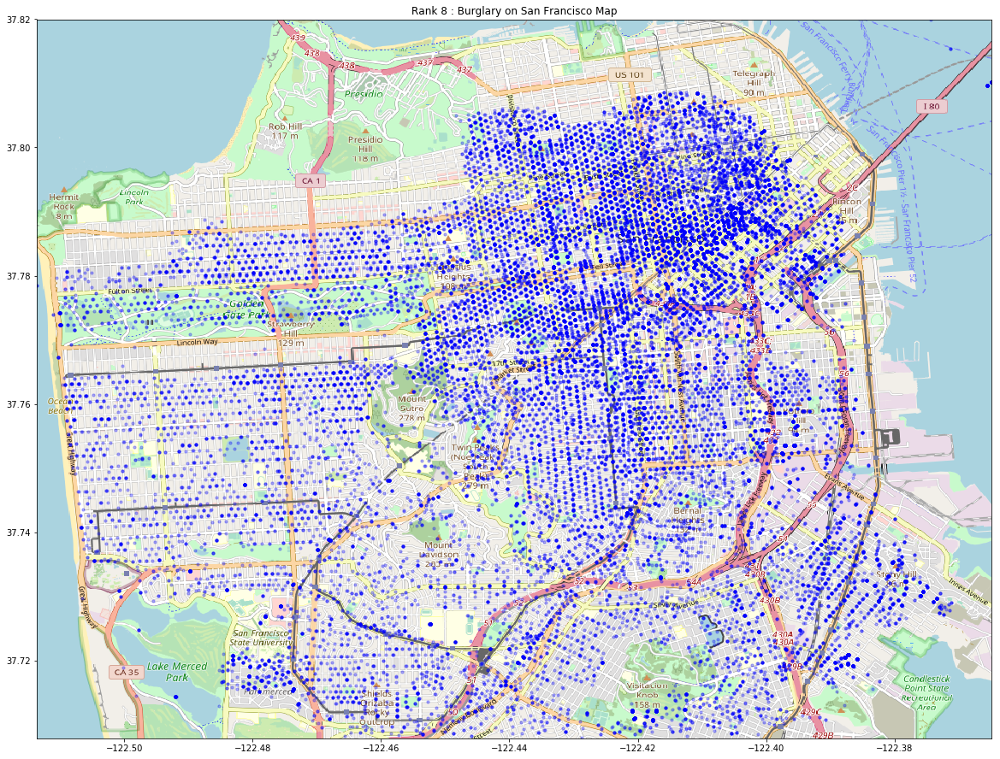

In [15]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Burglary.X, Burglary.Y, zorder=1, alpha= 0.3, c='b', s=10)
ax.set_title('Rank 8 : Burglary on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

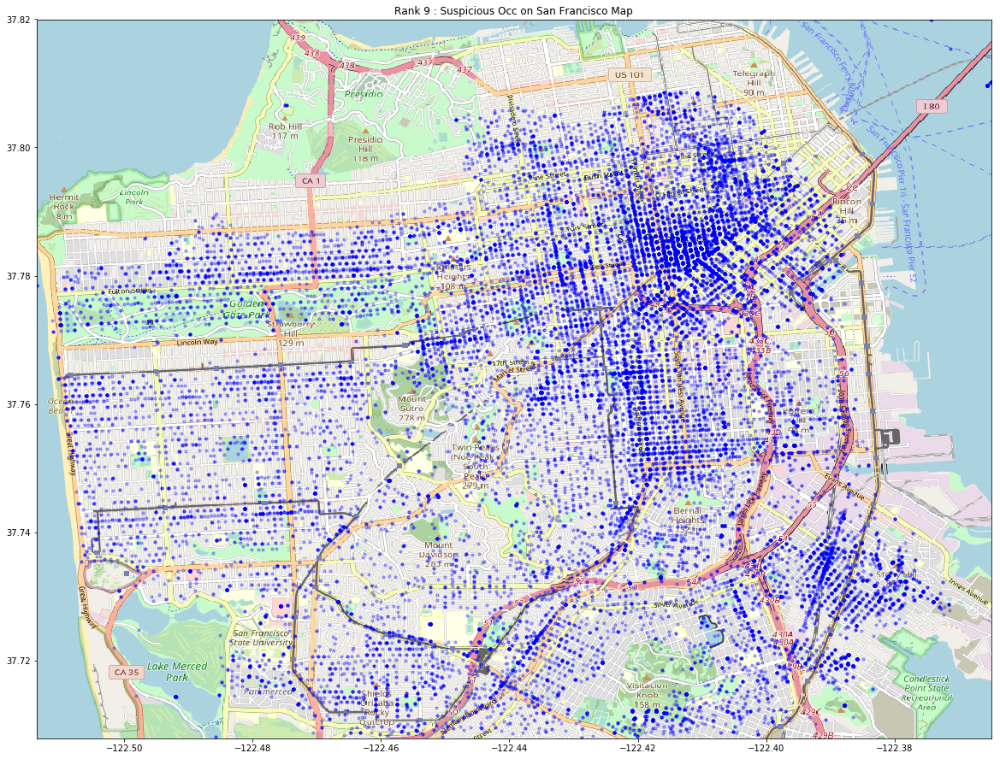

In [16]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(SuspiciousOcc.X, SuspiciousOcc.Y, zorder=1, alpha= 0.30, c='b', s=10)
ax.set_title('Rank 9 : Suspicious Occ on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')

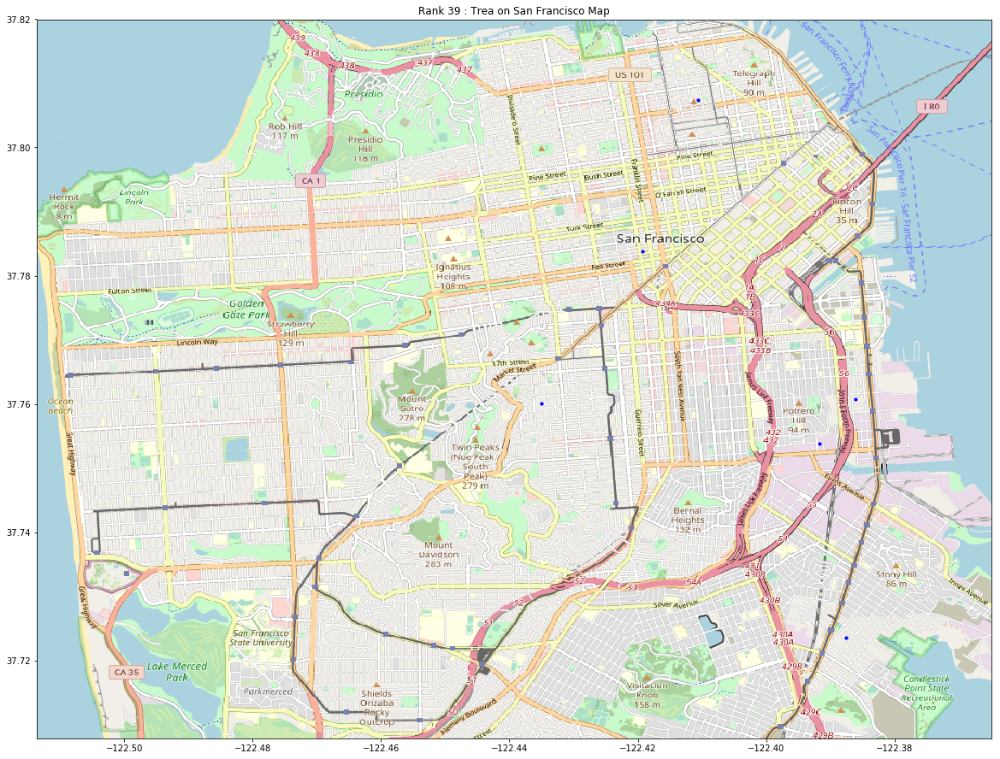

In [17]:
fig, ax = plt.subplots(figsize = (20,20))
ax.scatter(Trea.X, Trea.Y, zorder=1, alpha= 1, c='b', s=10)
ax.set_title('Rank 39 : Trea on San Francisco Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(SanFranciscoMap, zorder=0, extent = BBox, aspect= 'equal')